In [1]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import sqlite3
import pandas as pd

db = sqlite3.connect('preprocgoogle.db')

df = pd.read_sql_query("select preproc from tweet", db)

In [6]:
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(2,2))
fit_vect = count_vect.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect.shape)



CountVectorizer Shape: (160253, 1000)


In [7]:
lda = LatentDirichletAllocation(n_components=15, random_state=0)
lda.fit(fit_vect)


LatentDirichletAllocation(n_components=15, random_state=0)

In [11]:
print(lda.components_.shape)
lda.components_

(5, 1000)


array([[2.53759426e+02, 9.64455441e+01, 3.79496741e+01, ...,
        2.00614227e-01, 9.86782425e+01, 2.00596965e-01],
       [8.69386012e-01, 2.02828014e-01, 2.06728791e-01, ...,
        2.00501687e-01, 5.20066192e+00, 4.18188294e+02],
       [2.52658732e+02, 2.07940713e-01, 8.09216995e+02, ...,
        4.64196965e+02, 1.11912482e+01, 2.01692233e-01],
       [2.82550741e+02, 1.56153298e+02, 6.70016820e+02, ...,
        2.00899403e-01, 1.32033363e+02, 2.05190019e-01],
       [2.80161716e+02, 2.20990389e+02, 5.56097822e+01, ...,
        2.01019980e-01, 3.71896484e+02, 2.04226500e-01]])

In [13]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
display_topic_words(lda, feature_names, 15)



Topic # 0
google*23174.4 + search*13030.6 + google search*8133.3 + like*4955.8 + pixel*4075.2 + phone*2731.8 + use*2402.9 + let*2316.3 + look*2170.5 + google pixel*2099.2 + want*1874.4 + result*1734.7 + quick*1688.1 + dont*1652.2 + simple*1607.2

Topic # 1
google*12020.2 + amp*6243.5 + seo*2616.1 + review*2486.6 + online*2409.8 + image*2370.4 + search*2329.9 + apple*2215.9 + twitter*1901.1 + listen*1886.2 + radio*1872.2 + website*1741.7 + nowplaying*1676.2 + assistant*1644.2 + uk*1589.6

Topic # 2
google*25056.6 + account*6681.2 + app*5131.8 + play*4683.1 + map*4288.2 + google map*3625.2 + google play*3553.7 + store*3374.5 + new*2828.1 + cloud*2826.2 + youtube*2734.9 + apple*2409.4 + year*2369.4 + video*2282.5 + download*2222.3

Topic # 3
google*37060.0 + ai*10801.1 + bard*5801.5 + ha*5718.1 + just*5497.4 + dont*5102.2 + say*3948.9 + ad*3891.3 + people*3649.6 + chatgpt*3641.0 + google bard*3083.6 + new*2879.8 + know*2868.0 + like*2503.3 + just google*2490.0

Topic # 4
google*58059.7 +

In [15]:
doc_topics = lda.transform(fit_vect)
print(doc_topics.shape)
print(doc_topics[:3])

(160253, 5)
[[0.008983   0.08920016 0.10830399 0.78463481 0.00887803]
 [0.04055483 0.04020814 0.0403513  0.83829546 0.04059027]
 [0.83706464 0.04035829 0.04089085 0.0404957  0.04119053]]


In [17]:
a1 = lda.perplexity(fit_vect)
print(a1)

402.52708341877576


In [46]:
#클러스터 개수 3 a11 위와 max df 변화
count_vect11 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect11 = count_vect11.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect11.shape)

CountVectorizer Shape: (160253, 1000)


In [47]:
lda11 = LatentDirichletAllocation(n_components=3, random_state=0)
lda11.fit(fit_vect11)

LatentDirichletAllocation(n_components=3, random_state=0)

In [48]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect11.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
display_topic_words(lda11, feature_names, 15)


Topic # 0
just*14586.1 + wa*12699.7 + like*11816.6 + dont*10521.5 + know*9392.0 + im*8487.4 + people*6695.1 + use*6346.3 + time*5087.6 + make*4826.0 + thing*4819.9 + say*4807.7 + look*4669.7 + think*4624.3 + want*4273.9

Topic # 1
search*15274.1 + google search*8126.6 + amp*7950.9 + ad*3886.6 + business*2736.3 + twitter*2510.1 + review*2486.8 + online*2415.7 + news*2379.7 + website*2370.2 + seo*2168.8 + drive*2121.0 + link*1908.9 + amazon*1898.5 + listen*1886.2

Topic # 2
ai*10272.9 + account*6681.2 + bard*5810.9 + new*5792.7 + app*5694.1 + play*4948.3 + ha*4589.2 + free*4406.4 + map*4288.3 + apple*3920.4 + google play*3778.9 + chatgpt*3698.9 + store*3647.5 + google map*3625.3 + youtube*3310.4


In [49]:
a11 = lda11.perplexity(fit_vect11)
print(a11)

592.2847893856521


In [23]:
#max_df 바꿔보기
count_vect0 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect0 = count_vect0.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect0.shape)


CountVectorizer Shape: (160253, 1000)


In [24]:
lda0 = LatentDirichletAllocation(n_components=5, random_state=0)
lda0.fit(fit_vect0)

LatentDirichletAllocation(n_components=5, random_state=0)

In [25]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect0.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
display_topic_words(lda0, feature_names, 15)


Topic # 0
use*7461.7 + pixel*4075.2 + ad*3818.5 + like*3214.5 + use google*3135.0 + new*3064.1 + phone*3013.7 + cloud*2826.2 + business*2776.0 + help*2674.1 + using*2620.5 + let*2549.3 + dont*2186.9 + google pixel*2099.2 + want*2072.8

Topic # 1
search*13029.7 + google search*7007.6 + amp*4942.0 + review*2470.3 + online*2390.3 + seo*2202.8 + listen*1886.2 + radio*1872.2 + twitter*1777.9 + quick*1756.0 + form*1723.0 + music*1671.7 + assistant*1644.2 + uk*1595.1 + website*1480.4

Topic # 2
account*6680.5 + app*5704.1 + play*4950.7 + apple*4298.4 + map*4288.2 + google play*3779.2 + store*3649.6 + google map*3625.2 + youtube*2973.9 + photo*2307.8 + download*2263.2 + year*2226.2 + video*2013.0 + io*1956.3 + delete*1909.2

Topic # 3
ai*11000.1 + bard*5811.2 + ha*5808.8 + chatgpt*3695.5 + just*3396.3 + say*3300.3 + google bard*3086.2 + new*3067.6 + just google*2464.3 + search*2300.6 + news*1911.1 + source*1811.1 + microsoft*1805.3 + model*1614.2 + simple*1605.9

Topic # 4
wa*13177.9 + just*1

In [26]:
a0 = lda.perplexity(fit_vect0)
print(a0)

721.1412233781635


In [ ]:
#cluster 갯수 바꿔보기 a11(3)-a0(5)-a2(10)-a3(15)-a4(20)-a5(25)-a6(30)-a7(35)
#a8(40)-a9(45)-a10(50)

In [27]:
count_vect2 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect2 = count_vect2.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect2.shape)
lda2 = LatentDirichletAllocation(n_components=10, random_state=0)
lda2.fit(fit_vect2)

CountVectorizer Shape: (160253, 1000)


LatentDirichletAllocation(random_state=0)

In [40]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect2.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a2 = display_topic_words(lda2, feature_names, 15)



Topic # 0
use*8132.0 + new*3355.1 + use google*3138.9 + ad*2999.3 + data*2874.1 + cloud*2825.8 + like*1998.8 + want*1793.6 + help*1766.6 + google cloud*1726.6 + service*1691.6 + business*1624.8 + learn*1470.6 + google ad*1414.2 + user*1393.5

Topic # 1
search*13090.3 + google search*8084.5 + twitter*2625.9 + review*2487.1 + amp*2256.0 + seo*2209.0 + website*2004.5 + content*1900.1 + result*1860.2 + quick*1807.2 + page*1748.3 + medium*1601.6 + site*1466.2 + engine*1385.1 + quick google*1280.1

Topic # 2
account*6679.3 + app*5683.2 + play*4951.1 + google play*3779.1 + store*3649.9 + apple*3107.0 + youtube*2802.9 + download*2263.1 + year*2038.5 + delete*1909.1 + video*1766.6 + inactive*1628.1 + app store*1452.0 + google account*1317.1 + pay*1217.9

Topic # 3
just*8524.4 + ha*5750.1 + say*5015.5 + people*4780.2 + dont*2525.4 + just google*2490.9 + need*2206.9 + youre*2100.0 + like*2072.4 + thats*1843.0 + fact*1707.7 + thing*1608.4 + simple*1587.4 + doesnt*1499.1 + right*1402.8

Topic # 4


In [33]:
type(a2)

NoneType

In [29]:
a2 = lda2.perplexity(fit_vect2)
print(a2)

554.3298665329728


In [37]:
#import matplotlib.pyplot as plt
#from wordcloud import WordCloud
#wc = WordCloud()
##########################################

In [4]:
count_vect3 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect3 = count_vect3.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect3.shape)
lda3 = LatentDirichletAllocation(n_components=15, random_state=0)
lda3.fit(fit_vect3)

CountVectorizer Shape: (160253, 1000)


LatentDirichletAllocation(n_components=15, random_state=0)

In [44]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect3.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a3 = display_topic_words(lda3, feature_names, 15)
#lda3 feature를 wordcloud에 넣어주기


Topic # 0
use*8323.5 + use google*3139.1 + cloud*2691.2 + want*2432.4 + data*1907.6 + google cloud*1679.1 + help*1313.3 + learn*1112.2 + access*1022.9 + user*920.0 + dont*905.3 + security*878.9 + calendar*787.0 + information*753.6 + sign*700.0

Topic # 1
search*13078.2 + google search*8133.4 + review*2484.7 + twitter*2366.4 + seo*2205.8 + result*1839.8 + quick*1796.8 + website*1475.1 + page*1398.3 + engine*1385.1 + content*1356.0 + quick google*1280.0 + site*1257.5 + medium*1239.7 + court*1141.1

Topic # 2
account*6681.1 + youtube*3580.4 + year*3227.3 + video*3161.6 + delete*1909.1 + inactive*1628.1 + gmail*1418.0 + old*1372.7 + google account*1317.1 + email*1057.2 + havent*984.8 + meet*958.1 + inactive account*949.1 + google delete*869.1 + deleting*856.1

Topic # 3
ha*8357.0 + new*3885.8 + source*1812.4 + google ha*1369.6 + second*1220.7 + internet*1174.7 + say*1117.8 + great*1097.5 + fact*1031.1 + time*809.8 + india*749.3 + update*720.9 + come*675.1 + data*663.5 + post*662.1

Topic 

In [45]:
a3 = lda3.perplexity(fit_vect3)
print(a3)

546.5077782051902


In [15]:
bb = 
bb

[{}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}]

In [22]:
bb = [dict() for i in range(15)]

def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        
        for i in top_indexes:
            bb[topic_index][feature_names[i]] = round(topic[i])

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect3.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a3 = display_topic_words(lda3, feature_names, 100)
#lda3 feature를 wordcloud에 넣어주기

In [20]:
bb[0]

{'use': 8324,
 'use google': 3139,
 'cloud': 2691,
 'want': 2432,
 'data': 1908,
 'google cloud': 1679,
 'help': 1313,
 'learn': 1112,
 'access': 1023,
 'user': 920,
 'dont': 905,
 'security': 879,
 'calendar': 787,
 'information': 754,
 'sign': 700}

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
wc = WordCloud(background_color = 'white', max_font_size = 60)
for i in range(15):
    cloud = wc.generate_from_frequencies(bb[i])
    cloud.to_file('cluster15-' + str(i) + '.jpg')
    plt.figure(figsize = (10, 8))
    plt.axis('off')
    plt.imshow(cloud)
    plt.show()


In [52]:
count_vect4 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect4 = count_vect4.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect4.shape)
lda4 = LatentDirichletAllocation(n_components=20, random_state=0)
lda4.fit(fit_vect4)

CountVectorizer Shape: (160253, 1000)


LatentDirichletAllocation(n_components=20, random_state=0)

In [53]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect4.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a4 = display_topic_words(lda4, feature_names, 15)



Topic # 0
use*8331.9 + want*3343.4 + use google*3139.0 + user*1094.2 + dont*973.4 + list*949.4 + access*854.5 + sign*798.2 + calendar*797.0 + group*698.3 + event*585.8 + google calendar*518.0 + set*515.2 + ur*501.0 + student*475.0

Topic # 1
search*14227.1 + google search*8133.4 + review*2460.1 + twitter*2340.5 + seo*2215.4 + result*1822.6 + quick*1768.6 + website*1450.3 + engine*1385.0 + quick google*1280.0 + medium*1197.1 + page*1194.3 + court*1141.0 + search engine*1130.0 + social*1063.2

Topic # 2
account*6681.0 + youtube*3586.4 + video*3246.9 + year*3181.5 + delete*1909.0 + inactive*1628.0 + old*1331.3 + google account*1317.0 + gmail*1239.8 + havent*1028.9 + meet*958.0 + inactive account*949.0 + google delete*869.0 + deleting*856.0 + security*828.0

Topic # 3
ha*8182.8 + just*4423.6 + just google*2311.3 + new*2000.2 + fact*1646.6 + come*1526.9 + source*1374.9 + google ha*1368.6 + great*1230.3 + article*1206.5 + say*957.7 + believe*777.1 + read*764.7 + internet*744.9 + earth*729.0

In [54]:
a4 = lda4.perplexity(fit_vect4)
print(a4)

551.6181439616661


In [60]:
count_vect5 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect5 = count_vect5.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect5.shape)
lda5 = LatentDirichletAllocation(n_components=25, random_state=0)
lda5.fit(fit_vect5)

CountVectorizer Shape: (160253, 1000)


LatentDirichletAllocation(n_components=25, random_state=0)

In [61]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect5.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a5 = display_topic_words(lda5, feature_names, 15)



Topic # 0
want*4311.8 + email*1261.5 + access*1034.9 + list*1003.2 + th*947.2 + new*939.6 + set*909.1 + group*815.7 + calendar*798.6 + sign*792.6 + event*766.2 + information*740.2 + option*725.9 + report*724.0 + user*713.1

Topic # 1
twitter*3169.4 + review*2487.0 + website*2222.4 + seo*2023.9 + content*1869.6 + page*1778.2 + site*1463.4 + engine*1385.0 + facebook*1274.9 + court*1141.0 + search engine*1130.0 + amp*968.4 + google review*855.0 + search*824.9 + supreme*703.0

Topic # 2
account*6681.0 + youtube*3585.6 + year*3538.0 + video*3009.7 + delete*1909.0 + inactive*1628.0 + old*1464.4 + gmail*1416.3 + google account*1317.0 + havent*1079.0 + meet*958.0 + inactive account*949.0 + google delete*869.0 + deleting*856.0 + channel*753.6

Topic # 3
ha*7902.1 + just*5552.2 + just google*2475.6 + come*2248.8 + fact*1725.3 + source*1571.1 + google ha*1369.7 + people*793.6 + india*631.1 + claim*612.6 + matter*605.1 + country*527.0 + probably*495.1 + government*467.5 + theyre*464.1

Topic # 4


In [62]:
a5 = lda5.perplexity(fit_vect5)
print(a5)

536.3699541810181


In [66]:
count_vect6 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect6 = count_vect6.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect5.shape)
lda6 = LatentDirichletAllocation(n_components=30, random_state=0)
lda6.fit(fit_vect6)

CountVectorizer Shape: (160253, 1000)


LatentDirichletAllocation(n_components=30, random_state=0)

In [67]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect6.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a6 = display_topic_words(lda6, feature_names, 15)


Topic # 0
user*1664.5 + access*1098.4 + list*1064.0 + report*973.2 + set*869.2 + group*825.1 + calendar*801.4 + sign*794.2 + event*792.1 + option*761.7 + example*730.6 + create*722.7 + student*706.4 + ur*651.5 + email*624.7

Topic # 1
website*2386.1 + seo*2114.4 + content*1930.1 + site*1467.0 + engine*1385.0 + search*1205.6 + search engine*1130.0 + podcast*978.0 + amp*974.1 + spotify*968.0 + marketing*820.4 + podcasts*801.0 + web*770.0 + follow*753.6 + page*673.9

Topic # 2
account*6681.0 + year*3784.4 + youtube*2749.2 + video*2738.8 + delete*1909.0 + inactive*1628.0 + old*1458.8 + gmail*1411.1 + google account*1317.0 + havent*1131.4 + inactive account*949.0 + google delete*869.0 + deleting*856.0 + channel*763.1 + policy*655.0

Topic # 3
ha*8417.8 + come*2229.2 + fact*1729.5 + source*1412.5 + google ha*1369.9 + country*1155.2 + india*779.8 + matter*604.8 + just*559.6 + claim*552.2 + people*534.2 + theyre*518.4 + say*500.2 + new*449.5 + evidence*444.8

Topic # 4
wa*13320.8 + free*3694.

In [68]:
a6 = lda6.perplexity(fit_vect6)
print(a6)

548.5016449738372


In [70]:
count_vect7 = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect7 = count_vect7.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect7.shape)
lda7 = LatentDirichletAllocation(n_components=35, random_state=0)
lda7.fit(fit_vect7)

CountVectorizer Shape: (160253, 1000)


LatentDirichletAllocation(n_components=35, random_state=0)

In [ ]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect7.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a7 = display_topic_words(lda7, feature_names, 15)

In [ ]:
a7 = lda7.perplexity(fit_vect7)
print(a7)

In [ ]:
#cluster 갯수 바꿔보기 a11(3)-a0(5)-a2(10)-a3(15)-a4(20)-a5(25)-a6(30)-a7(35)
#a8(40)-a9(45)-a10(50)

plt.plot([a11,a0,a2,a3,a4,a5,a6,a7])
plt.show()

In [ ]:
#parameter 바꿔가며 돌려보기
#다른데서 토픽 15개 어떻게 나오는지

In [2]:
 #cluster 갯수 15개 고정, 파라미터 변화 max_features 100
count_vect_1 = CountVectorizer(max_df=0.5, max_features=100, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect_1 = count_vect_1.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect_1.shape)
lda_1 = LatentDirichletAllocation(n_components=15, random_state=0)
lda_1.fit(fit_vect_1)

CountVectorizer Shape: (160253, 100)


LatentDirichletAllocation(n_components=15, random_state=0)

In [4]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_1.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_1 = display_topic_words(lda_1, feature_names, 15)



Topic # 0
ai*11127.1 + using*3893.3 + cloud*2826.1 + try*2512.9 + tool*2332.9 + new*1888.2 + tech*1841.6 + help*667.8 + user*414.1 + service*141.2 + data*131.1 + way*84.0 + let*43.0 + ha*33.2 + chatgpt*12.8

Topic # 1
just*13980.0 + new*5437.9 + right*3775.1 + just google*2491.1 + photo*2288.6 + doesnt*2256.6 + business*2087.8 + android*304.0 + ha*80.2 + way*9.2 + help*3.4 + thing*3.0 + ive*1.6 + time*0.3 + work*0.3

Topic # 2
im*8495.6 + time*6782.0 + twitter*3630.1 + got*3109.1 + really*3086.2 + today*2572.9 + ive*2540.7 + like*1686.5 + help*1655.5 + thing*1002.3 + going*892.4 + way*462.9 + day*395.2 + just*368.6 + think*64.9

Topic # 3
wa*13323.5 + bard*5802.5 + account*5534.7 + chatgpt*3686.4 + google bard*3086.1 + year*1815.2 + didnt*298.9 + way*157.0 + like*61.4 + better*21.7 + just*21.3 + time*20.8 + good*15.4 + ha*8.5 + help*6.7

Topic # 4
people*6941.5 + look*4700.2 + let*3155.0 + better*2781.5 + lol*2673.1 + sure*2382.1 + like*2380.9 + didnt*1344.9 + make*1200.1 + help*598.3

In [5]:
a_1 = lda_1.perplexity(fit_vect_1)
print(a_1)

96.206977589427


In [13]:
cc = [dict() for i in range(15)]

def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        
        for i in top_indexes:
            cc[topic_index][feature_names[i]] = round(topic[i])

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_1.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_1 = display_topic_words(lda_1, feature_names, 100)
#lda3 feature를 wordcloud에 넣어주기

In [14]:
cc[0]

{'ai': 11127,
 'using': 3893,
 'cloud': 2826,
 'try': 2513,
 'tool': 2333,
 'new': 1888,
 'tech': 1842,
 'help': 668,
 'user': 414,
 'service': 141,
 'data': 131,
 'way': 84,
 'let': 43,
 'ha': 33,
 'chatgpt': 13,
 'bard': 9,
 'company': 7,
 'business': 6,
 'news': 6,
 'like': 4,
 'apple': 3,
 'content': 1,
 'make': 0,
 'today': 0,
 'seo': 0,
 'need': 0,
 'work': 0,
 'time': 0,
 'used': 0,
 'going': 0,
 'use': 0,
 'day': 0,
 'search': 0,
 'thing': 0,
 'ad': 0,
 'just': 0,
 'read': 0,
 'drive': 0,
 'best': 0,
 'better': 0,
 'google bard': 0,
 'android': 0,
 'image': 0,
 'doesnt': 0,
 'free': 0,
 'doe': 0,
 'apps': 0,
 'didnt': 0,
 'good': 0,
 'ive': 0,
 'right': 0,
 'mean': 0,
 'youtube': 0,
 'think': 0,
 'result': 0,
 'online': 0,
 'year': 0,
 'video': 0,
 'word': 0,
 'app': 0,
 'want': 0,
 'twitter': 0,
 'know': 0,
 'really': 0,
 'people': 0,
 'doc': 0,
 'tell': 0,
 'amp': 0,
 'account': 0,
 'youre': 0,
 'im': 0,
 'come': 0,
 'phone': 0,
 'link': 0,
 'dont': 0,
 'said': 0,
 'got': 0,


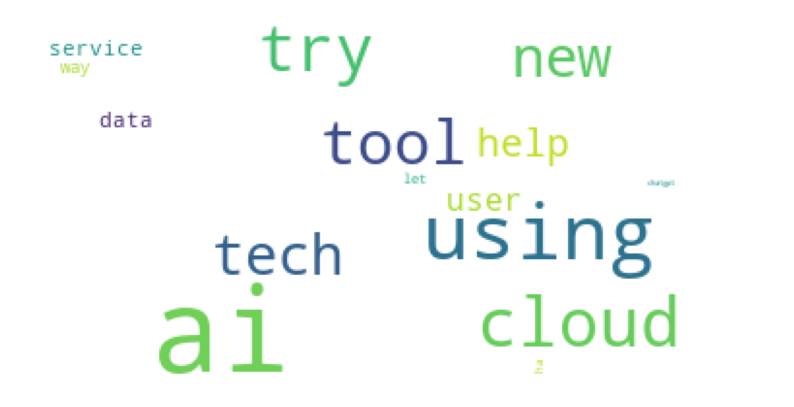

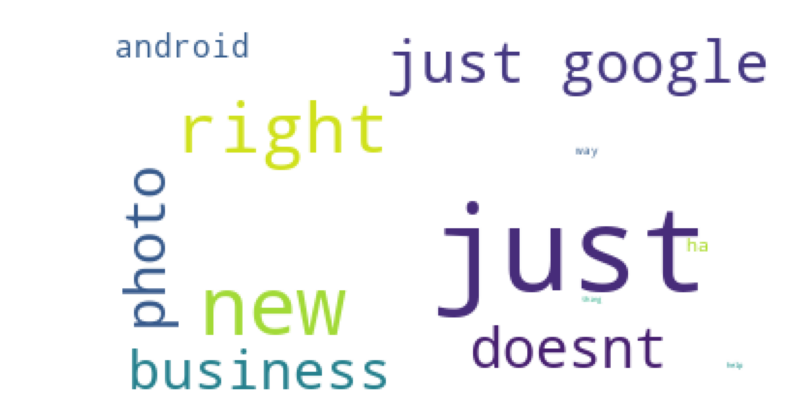

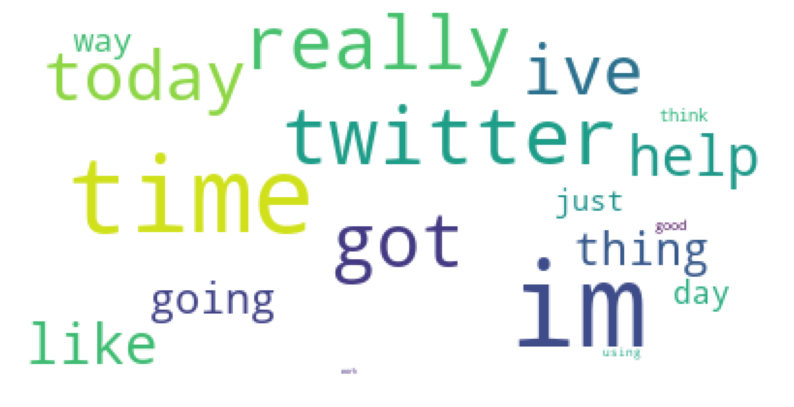

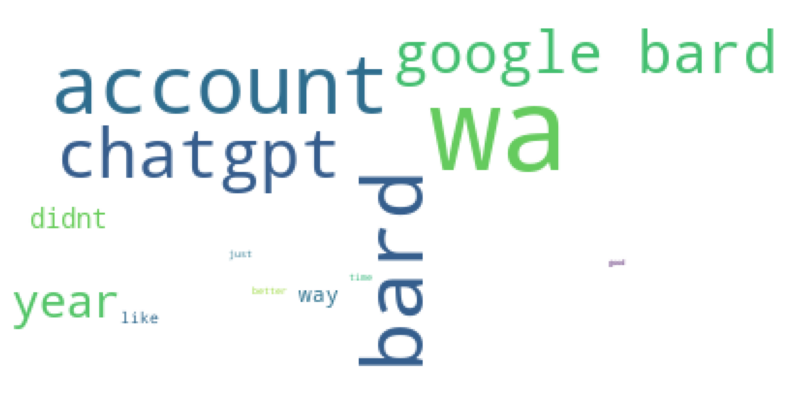

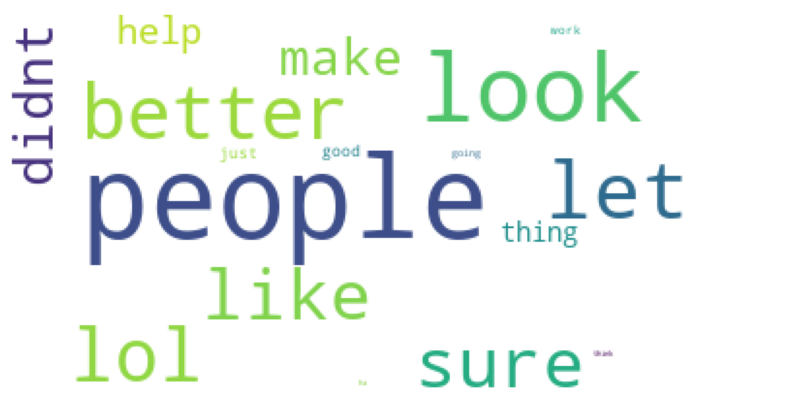

...

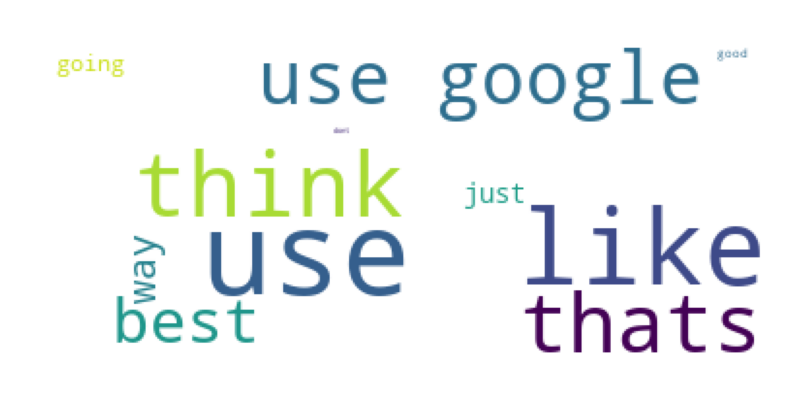

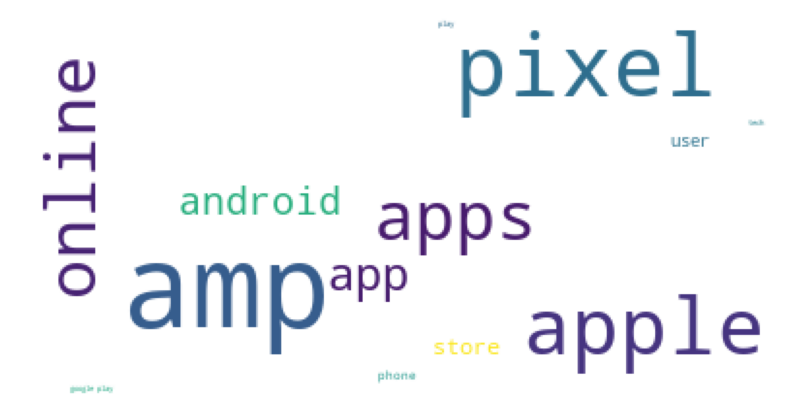

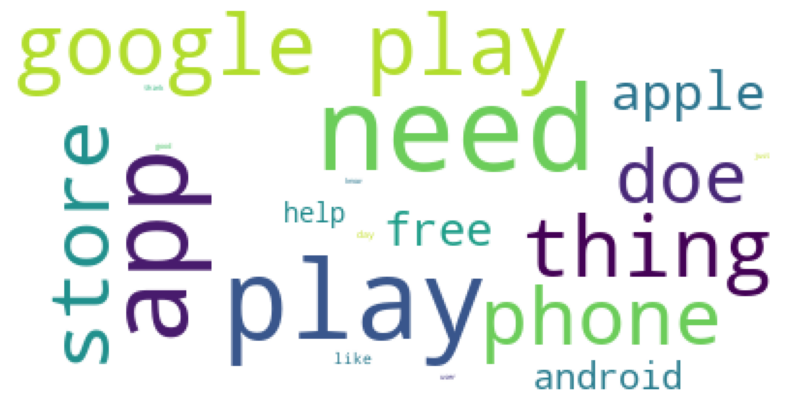

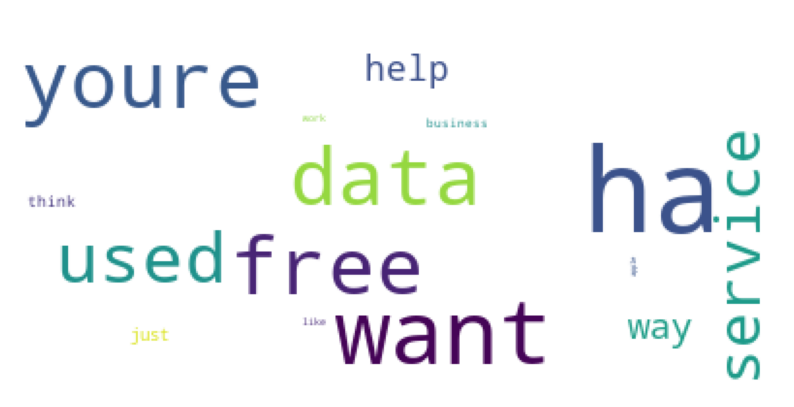

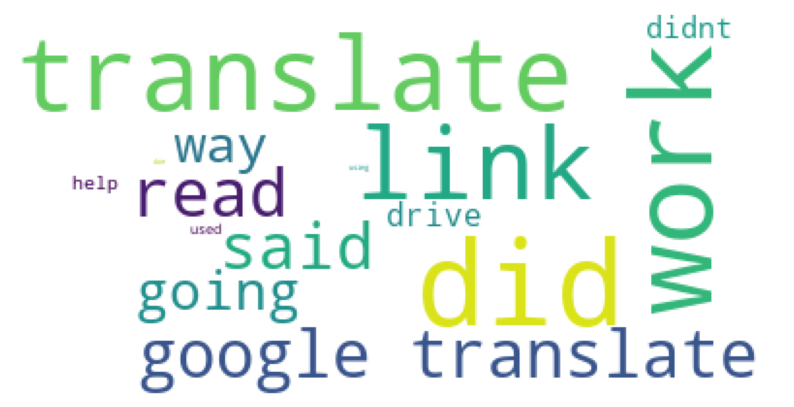

In [15]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
wc = WordCloud(background_color = 'white', max_font_size = 60)
for i in range(15):
    cloud = wc.generate_from_frequencies(cc[i])
    cloud.to_file('cluster15-maxfeature_100' + str(i) + '.jpg')
    plt.figure(figsize = (10, 8))
    plt.axis('off')
    plt.imshow(cloud)
    plt.show()


In [16]:
count_vect_2 = CountVectorizer(max_df=0.5, max_features=10000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect_2 = count_vect_2.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect_2.shape)
lda_2 = LatentDirichletAllocation(n_components=15, random_state=0)
lda_2.fit(fit_vect_2)

CountVectorizer Shape: (160253, 10000)


LatentDirichletAllocation(n_components=15, random_state=0)

In [17]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_2.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_2 = display_topic_words(lda_2, feature_names, 15)



Topic # 0
pixel*4074.7 + translate*3465.1 + image*3251.1 + google translate*2992.1 + google pixel*2099.1 + phone*1445.8 + search*1190.3 + search google*1124.0 + google image*1070.5 + pro*990.7 + click*760.7 + tab*736.6 + music*681.9 + new*677.7 + radio*655.3

Topic # 1
app*5403.7 + play*4930.4 + google play*3764.8 + store*3574.8 + apple*2334.4 + download*2262.9 + review*1989.1 + app store*1369.8 + play store*923.1 + free*853.7 + amp*818.5 + google review*806.7 + game*762.8 + available*708.1 + apple google*655.7

Topic # 2
account*6681.1 + use*4372.3 + youtube*3053.2 + year*2684.3 + use google*2448.4 + delete*1909.1 + inactive*1628.1 + video*1562.4 + email*1479.1 + old*1420.7 + gmail*1361.6 + google account*1317.1 + inactive account*949.1 + twitter*870.8 + google delete*869.1

Topic # 3
company*2402.8 + seo*2234.1 + cloud*2171.9 + ha*1641.2 + business*1546.2 + news*1443.3 + website*1392.2 + microsoft*1303.7 + google cloud*1265.7 + medium*1206.8 + like*1199.3 + apple*1178.2 + amazon*115

In [19]:
a_2 = lda_2.perplexity(fit_vect_2)
print(a_2)

2358.5241141661186


In [20]:
dd = [dict() for i in range(15)]

def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        
        for i in top_indexes:
            dd[topic_index][feature_names[i]] = round(topic[i])

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_2.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_2 = display_topic_words(lda_2, feature_names, 100)



In [21]:
dd[0]

{'pixel': 4075,
 'translate': 3465,
 'image': 3251,
 'google translate': 2992,
 'google pixel': 2099,
 'phone': 1446,
 'search': 1190,
 'search google': 1124,
 'google image': 1071,
 'pro': 991,
 'click': 761,
 'tab': 737,
 'music': 682,
 'new': 678,
 'radio': 655,
 'drop': 595,
 'just': 586,
 'samsung': 544,
 'ghana': 536,
 'music radio': 485,
 'ghana music': 484,
 'google click': 472,
 'pixel pro': 459,
 'fold': 458,
 'click image': 450,
 'image search': 444,
 'english': 434,
 'image tab': 407,
 'follow': 383,
 'amp': 382,
 'used': 352,
 'screenshot': 350,
 'pixel phone': 343,
 'tune': 331,
 'iphone': 328,
 'used google': 325,
 'pixel fold': 309,
 'camera': 294,
 'battery': 294,
 'best': 285,
 'tablet': 276,
 'language': 273,
 'let': 260,
 'case': 260,
 'radio app': 256,
 'image google': 252,
 'thought': 250,
 'tab drop': 249,
 'amp app': 242,
 'galaxy': 240,
 'share': 237,
 'africanmusic': 234,
 'ghanamusic africanmusic': 233,
 'radio just': 233,
 'onlineradio ghana': 233,
 'onliner

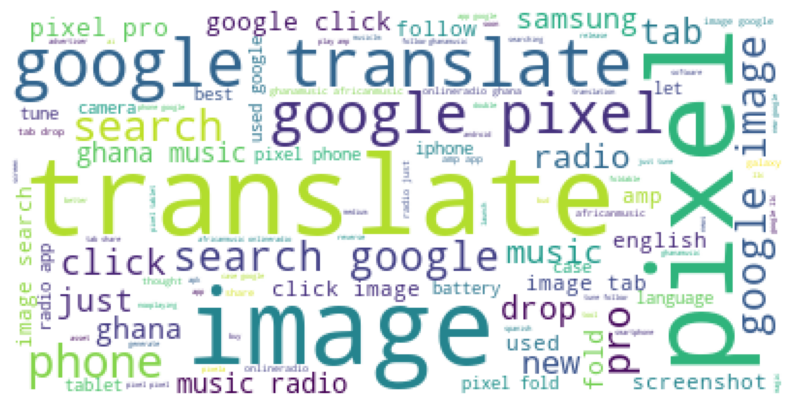

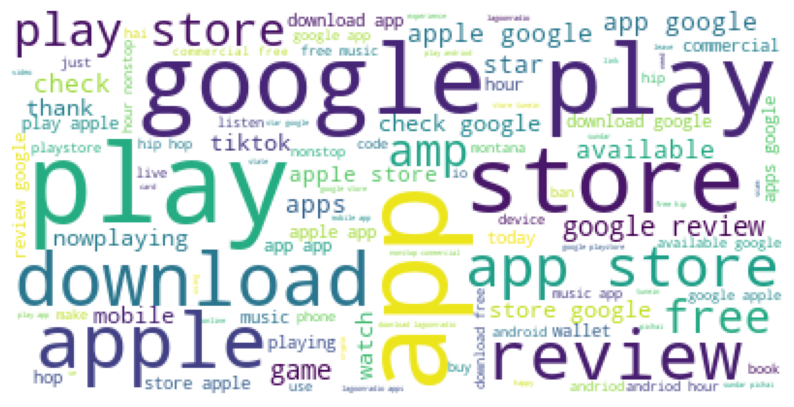

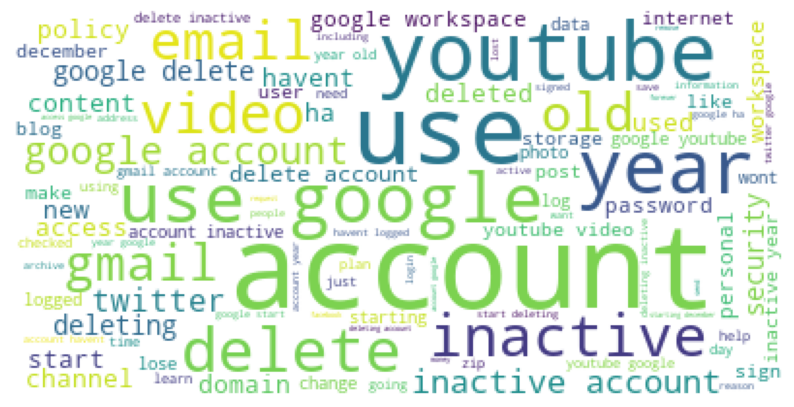

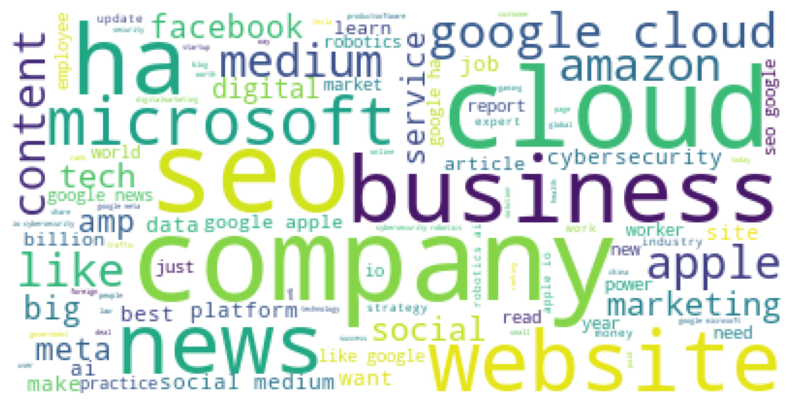

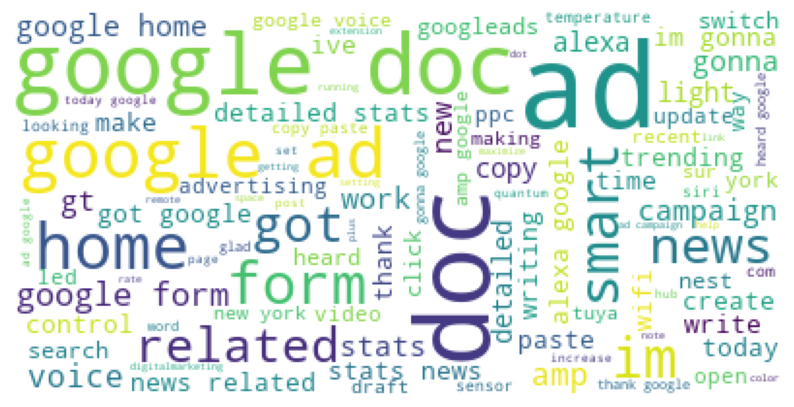

...

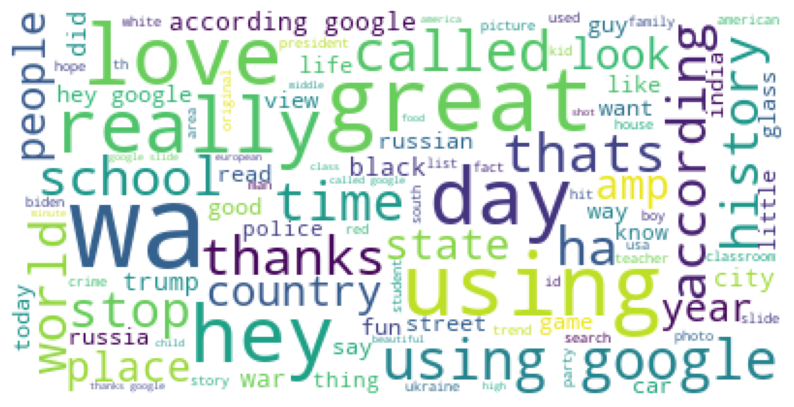

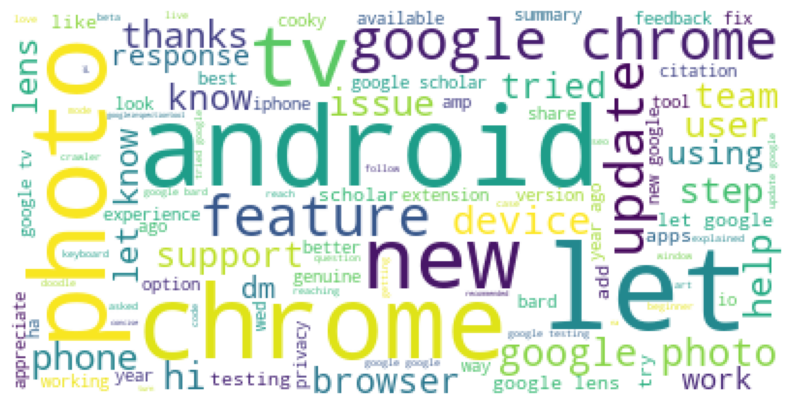

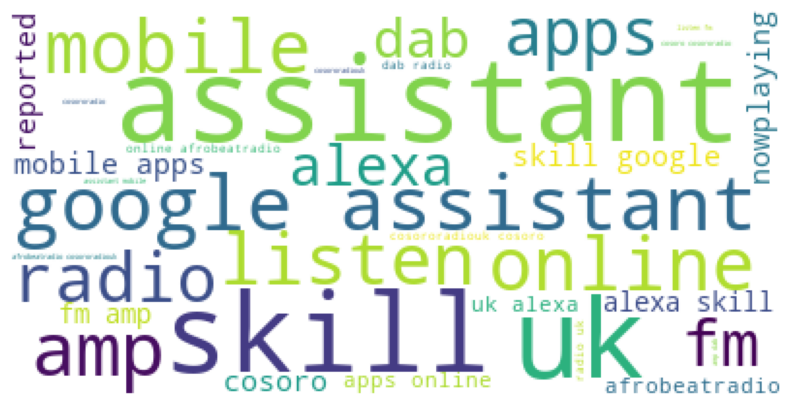

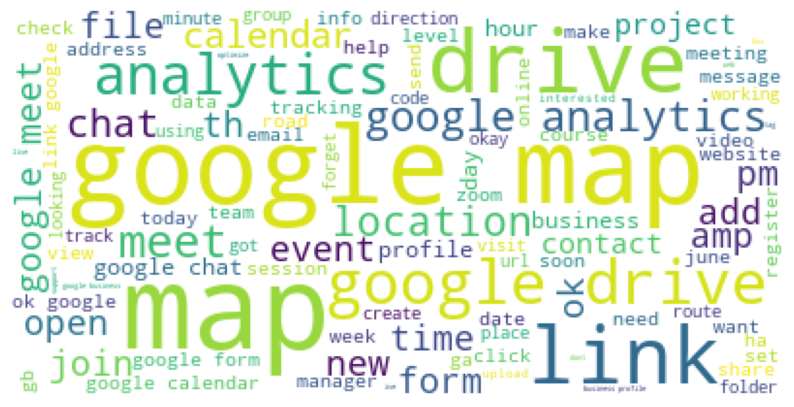

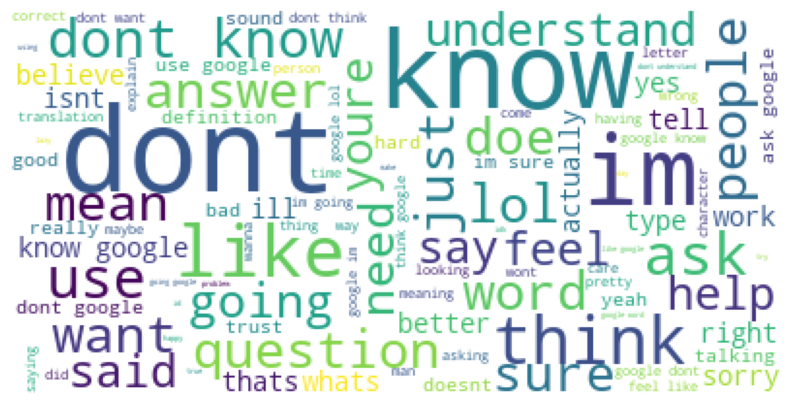

In [22]:
wc = WordCloud(background_color = 'white', max_font_size = 60)
for i in range(15):
    cloud = wc.generate_from_frequencies(dd[i])
    cloud.to_file('cluster15-maxfeature_100' + str(i) + '.jpg')
    plt.figure(figsize = (10, 8))
    plt.axis('off')
    plt.imshow(cloud)
    plt.show()

In [ ]:
#cluster 갯수 2500, 5000, 7500개

In [23]:
count_vect_3 = CountVectorizer(max_df=0.5, max_features=2500, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect_3 = count_vect_3.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect_3.shape)
lda_3 = LatentDirichletAllocation(n_components=15, random_state=0)
lda_3.fit(fit_vect_3)

CountVectorizer Shape: (160253, 2500)


LatentDirichletAllocation(n_components=15, random_state=0)

In [24]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_3.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_3 = display_topic_words(lda_3, feature_names, 15)


Topic # 0
bard*5811.1 + chatgpt*3649.3 + google bard*3086.1 + ai*2342.3 + data*1252.7 + sheet*1230.1 + better*967.2 + google sheet*967.1 + access*966.5 + gpt*881.0 + response*843.8 + chat*789.6 + bing*772.3 + use*717.4 + asked*641.3

Topic # 1
wa*6528.9 + say*5688.3 + ha*2858.2 + going*1618.5 + simple*1604.9 + second*1252.1 + google say*1096.7 + simple google*967.1 + help*950.1 + great*949.4 + im*932.4 + good*927.6 + thank*868.8 + google ha*824.7 + guy*790.6

Topic # 2
amp*3260.1 + website*2143.2 + love*1669.3 + team*1445.0 + update*1419.4 + seo*1241.4 + try*1164.2 + best*1022.4 + meet*955.1 + work*928.8 + help*885.9 + support*867.3 + calendar*848.1 + time*828.3 + link*822.4

Topic # 3
just*10536.2 + dont*5692.3 + use*5506.6 + like*5304.5 + people*4964.5 + think*3124.7 + want*2985.1 + use google*2828.5 + just google*2491.1 + im*2374.8 + youre*2266.8 + read*1713.7 + thats*1549.3 + word*1394.8 + actually*1233.3

Topic # 4
map*4288.1 + google map*3625.1 + doc*2865.0 + google doc*2504.8 +

In [41]:
a_3 = lda_3.perplexity()
print(a_3)
# perplexity normalize N분의 1 ->feature 갯수를 로그로 보냈을때 지수

1020.036989621539


In [ ]:
ee = [dict() for i in range(15)]

def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        
        for i in top_indexes:
            ee[topic_index][feature_names[i]] = round(topic[i])

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_3.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_3 = display_topic_words(lda_3, feature_names, 100)



In [27]:
ee[0]

{'bard': 5811,
 'chatgpt': 3649,
 'google bard': 3086,
 'ai': 2342,
 'data': 1253,
 'sheet': 1230,
 'better': 967,
 'google sheet': 967,
 'access': 966,
 'gpt': 881,
 'response': 844,
 'chat': 790,
 'bing': 772,
 'use': 717,
 'asked': 641,
 'add': 557,
 'text': 543,
 'ha': 532,
 'chatbot': 497,
 'content': 474,
 'prompt': 471,
 'using': 460,
 'answer': 454,
 'workspace': 448,
 'bard ai': 429,
 'web': 428,
 'gmail': 423,
 'openai': 418,
 'feature': 388,
 'gt': 386,
 'chatgpt google': 364,
 'apps': 360,
 'google workspace': 356,
 'googlebard': 353,
 'summary': 352,
 'available': 349,
 'google ai': 338,
 'source': 307,
 'write': 299,
 'citation': 293,
 'bard chatgpt': 288,
 'chat gpt': 286,
 'script': 276,
 'update': 274,
 'create': 269,
 'question': 267,
 'log': 264,
 'bardai': 261,
 'asked google': 255,
 'bard google': 247,
 'better google': 246,
 'eu': 244,
 'information': 243,
 'access google': 241,
 'genuine': 240,
 'microsoft': 240,
 'code': 238,
 'new': 228,
 'ai chatbot': 217,
 'w

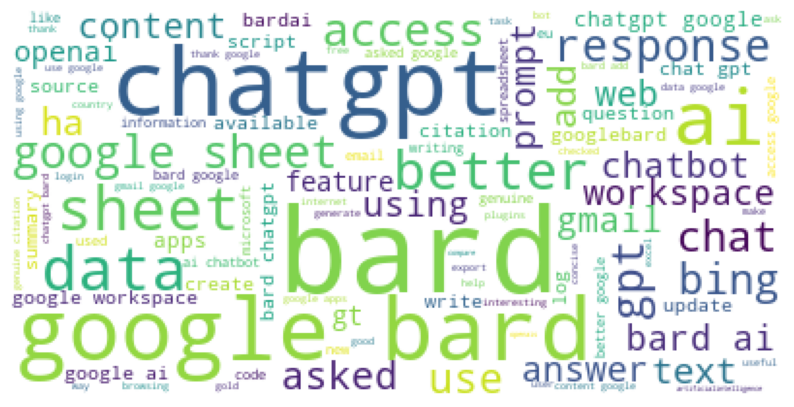

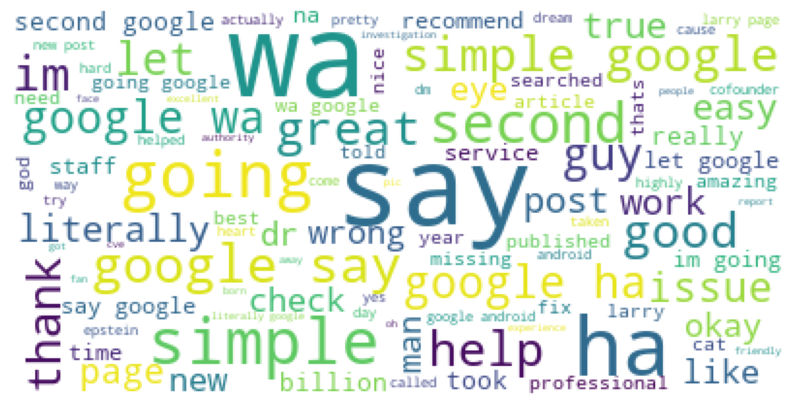

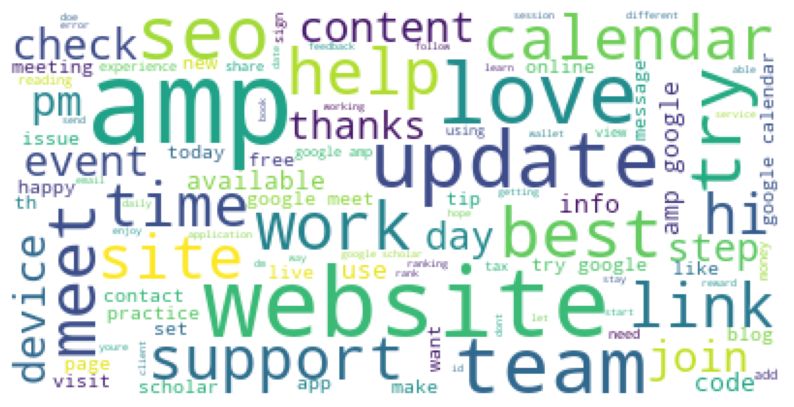

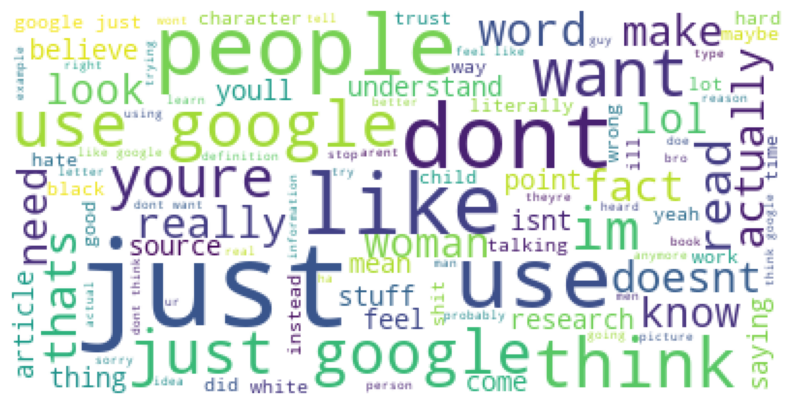

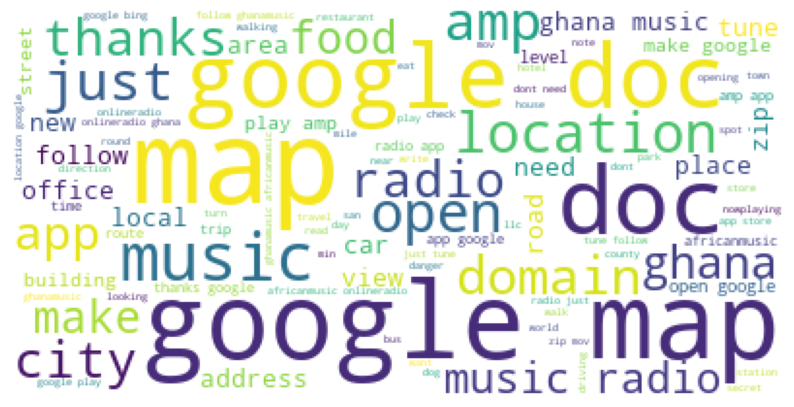

...

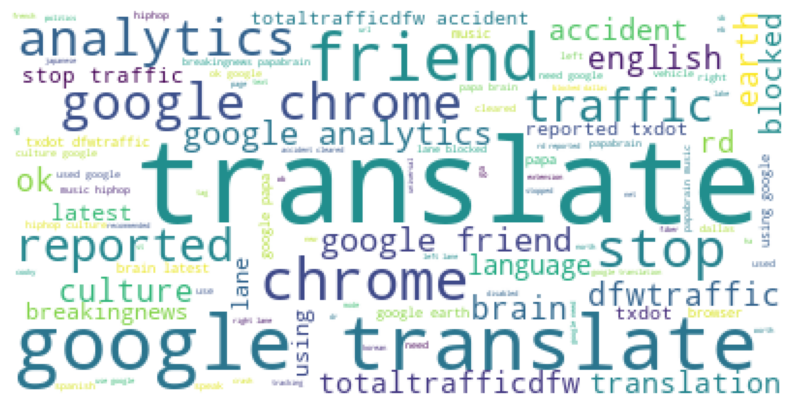

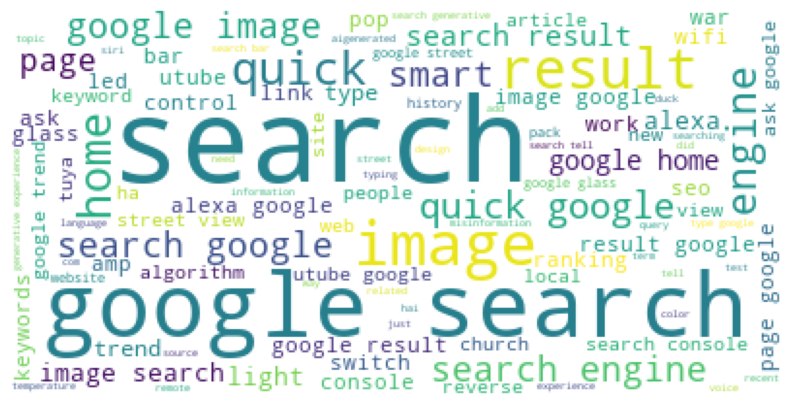

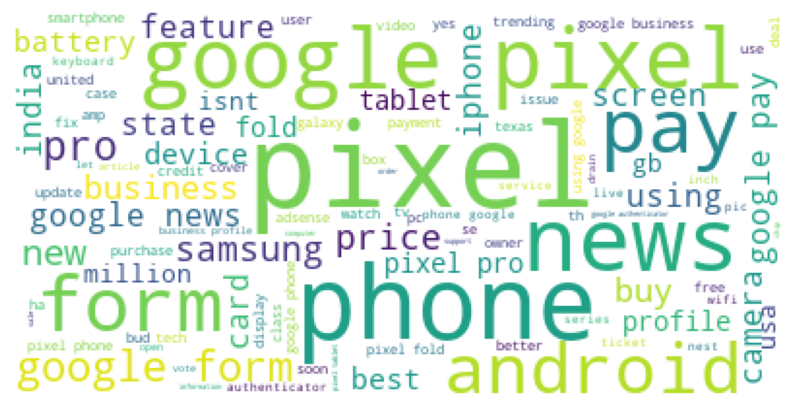

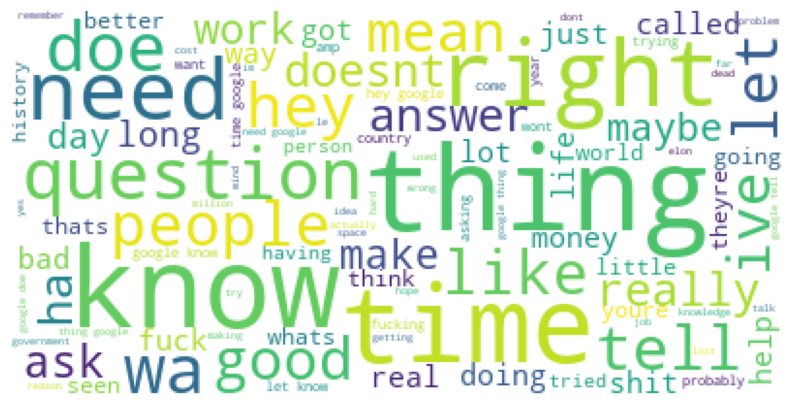

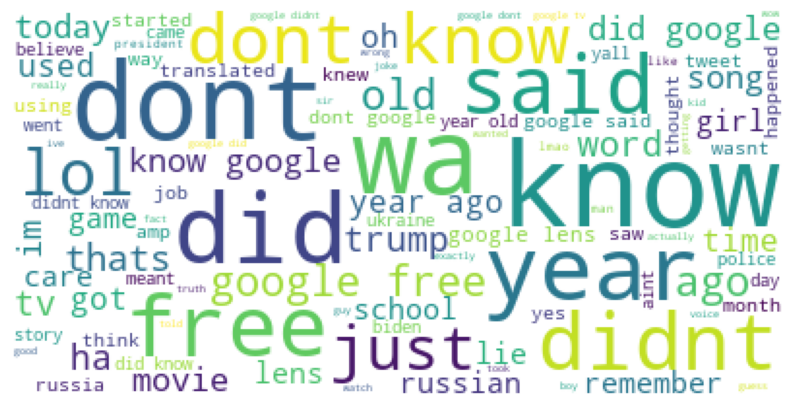

In [28]:
wc = WordCloud(background_color = 'white', max_font_size = 60)
for i in range(15):
    cloud = wc.generate_from_frequencies(ee[i])
    cloud.to_file('cluster15-maxfeature_2500' + str(i) + '.jpg')
    plt.figure(figsize = (10, 8))
    plt.axis('off')
    plt.imshow(cloud)
    plt.show()

In [29]:
count_vect_4 = CountVectorizer(max_df=0.5, max_features=5000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect_4 = count_vect_4.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect_4.shape)
lda_4 = LatentDirichletAllocation(n_components=15, random_state=0)
lda_4.fit(fit_vect_4)

CountVectorizer Shape: (160253, 5000)


LatentDirichletAllocation(n_components=15, random_state=0)

In [30]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_4.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_4 = display_topic_words(lda_4, feature_names, 15)


Topic # 0
ha*2822.2 + company*2164.4 + news*1463.1 + microsoft*1416.8 + amazon*1335.7 + tv*1054.7 + google ha*943.2 + apple*933.6 + tech*902.7 + big*854.6 + market*835.6 + hey*773.4 + million*747.5 + click*735.4 + tab*731.3

Topic # 1
play*4951.0 + app*4912.6 + google play*3779.1 + store*3650.1 + download*2263.1 + apple*1749.3 + app store*1452.1 + music*1409.4 + game*1154.8 + play store*923.1 + amp*889.2 + free*831.0 + radio*798.0 + app google*786.1 + nowplaying*715.3

Topic # 2
bard*5759.2 + chatgpt*3217.8 + google bard*3064.5 + new*2445.3 + analytics*1248.6 + friend*1112.8 + google friend*836.1 + according*835.1 + data*796.8 + google analytics*766.2 + map*706.0 + tool*651.5 + ai*633.9 + ha*622.8 + domain*594.7

Topic # 3
search*9795.4 + like*7408.1 + google search*4790.4 + ad*2925.3 + image*2836.6 + free*2680.3 + result*2333.6 + look*1566.3 + like google*1547.6 + simple*1313.6 + google ad*1268.3 + engine*1221.4 + google free*1192.1 + feel*1092.5 + search engine*1085.9

Topic # 4
amp

In [31]:
a_4 = lda_4.perplexity(fit_vect_4)
print(a_4)

1589.6881313890974


In [32]:
ff = [dict() for i in range(15)]

def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        
        for i in top_indexes:
            ff[topic_index][feature_names[i]] = round(topic[i])

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_4.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_4 = display_topic_words(lda_4, feature_names, 100)



In [33]:
ff[0]

{'ha': 2822,
 'company': 2164,
 'news': 1463,
 'microsoft': 1417,
 'amazon': 1336,
 'tv': 1055,
 'google ha': 943,
 'apple': 934,
 'tech': 903,
 'big': 855,
 'market': 836,
 'hey': 773,
 'million': 747,
 'click': 735,
 'tab': 731,
 'money': 714,
 'new': 697,
 'drop': 649,
 'share': 631,
 'search': 608,
 'just': 593,
 'stock': 582,
 'billion': 581,
 'image': 551,
 'meta': 538,
 'search google': 514,
 'hey google': 504,
 'google news': 499,
 'world': 489,
 'google click': 472,
 'china': 458,
 'ceo': 458,
 'click image': 450,
 'buy': 444,
 'large': 442,
 'published': 417,
 'image tab': 407,
 'government': 405,
 'india': 402,
 'android': 397,
 'education': 388,
 'google microsoft': 382,
 'cost': 381,
 'facebook': 356,
 'user': 350,
 'state': 335,
 'tesla': 327,
 'best': 323,
 'dollar': 313,
 'post': 310,
 'alert': 306,
 'googl': 300,
 'alphabet': 296,
 'data': 289,
 'like': 279,
 'amazon google': 278,
 'gaming': 277,
 'google amazon': 274,
 'model': 273,
 'practice': 272,
 'tax': 263,
 'sc

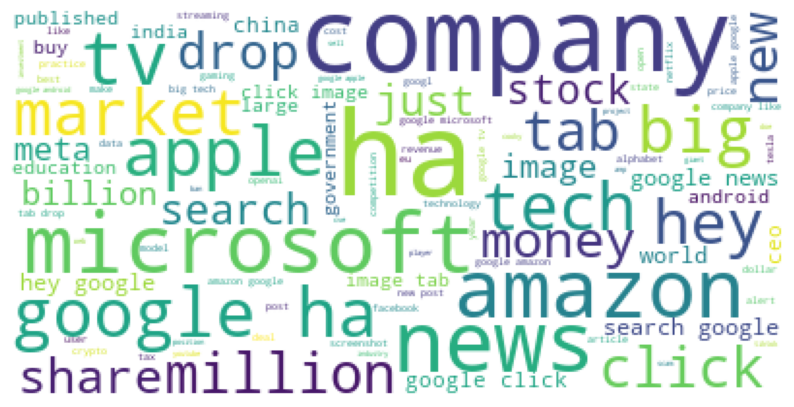

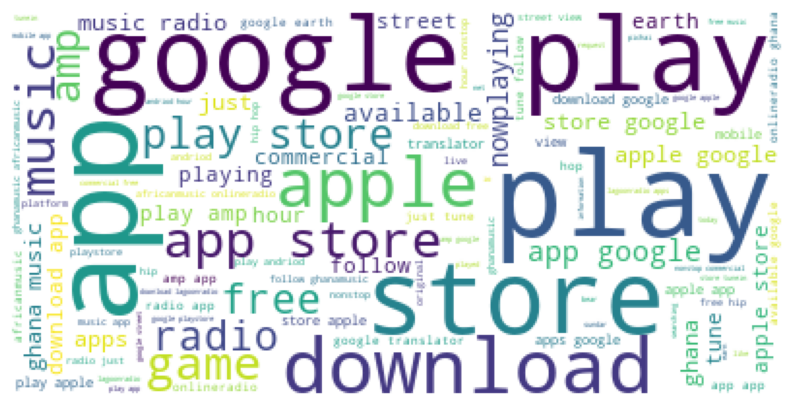

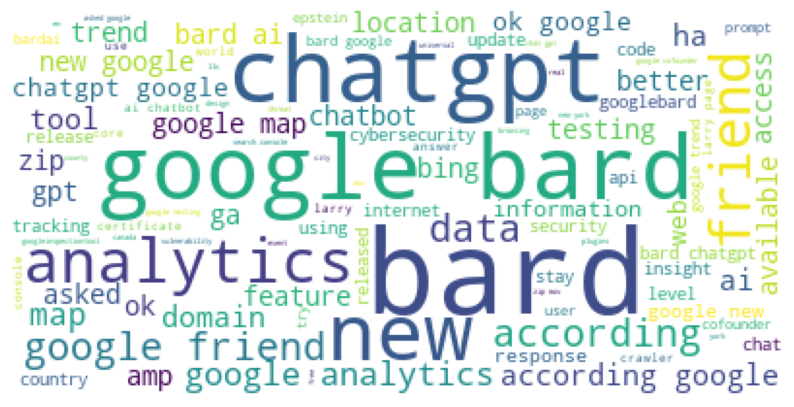

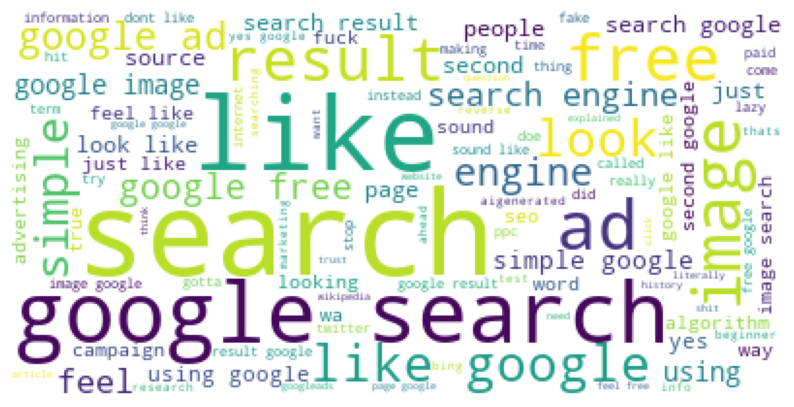

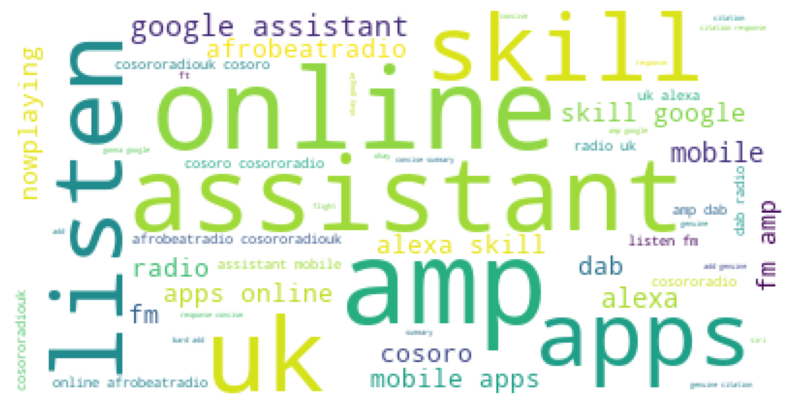

...

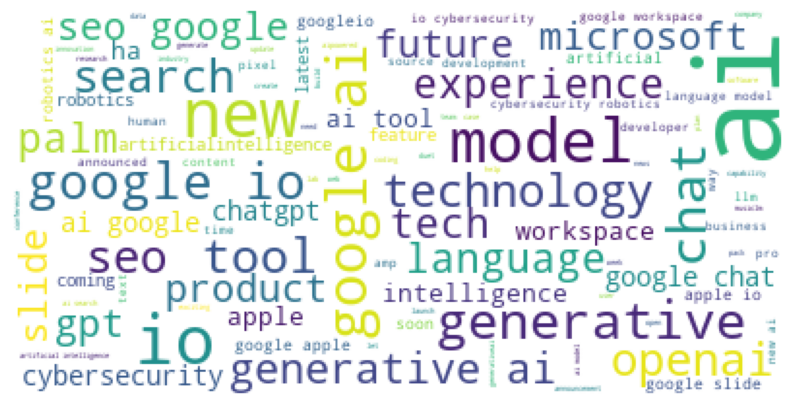

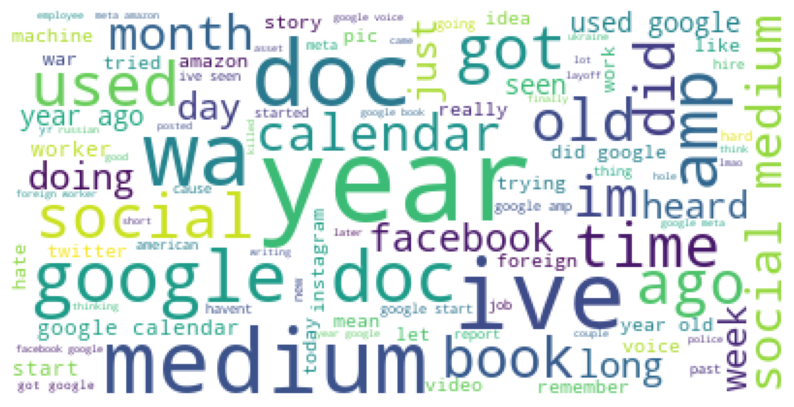

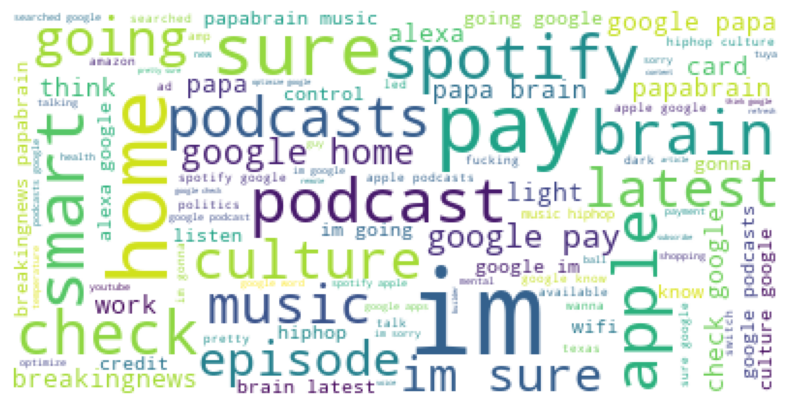

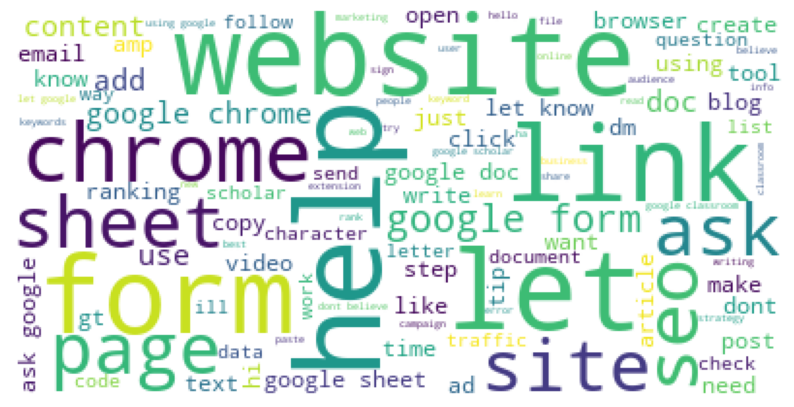

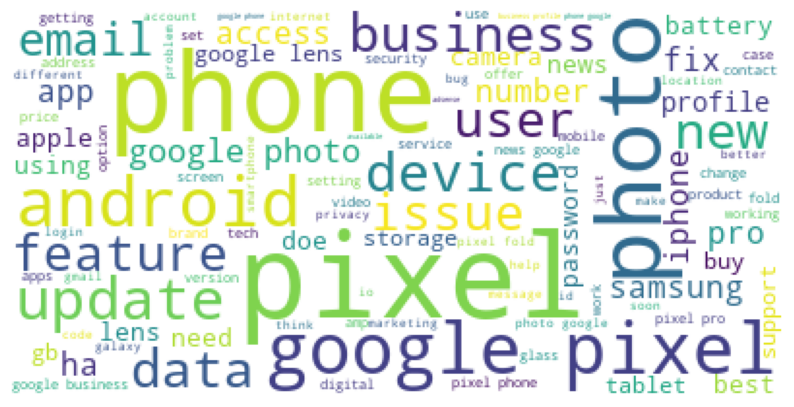

In [34]:
wc = WordCloud(background_color = 'white', max_font_size = 60)
for i in range(15):
    cloud = wc.generate_from_frequencies(ff[i])
    cloud.to_file('cluster15-maxfeature_5000' + str(i) + '.jpg')
    plt.figure(figsize = (10, 8))
    plt.axis('off')
    plt.imshow(cloud)
    plt.show()

In [35]:
count_vect_5 = CountVectorizer(max_df=0.5, max_features=7500, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect_5 = count_vect_5.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect_5.shape)
lda_5 = LatentDirichletAllocation(n_components=15, random_state=0)
lda_5.fit(fit_vect_5)

CountVectorizer Shape: (160253, 7500)


LatentDirichletAllocation(n_components=15, random_state=0)

In [36]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_5.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_5 = display_topic_words(lda_5, feature_names, 15)


Topic # 0
bard*5810.6 + ai*3663.4 + chatgpt*3504.1 + google bard*3084.0 + image*2933.8 + answer*1722.9 + question*1717.1 + search*1566.4 + doe*1546.9 + source*1324.9 + ha*1160.1 + google image*1071.1 + model*1038.9 + like*926.1 + information*807.3

Topic # 1
amp*1696.1 + assistant*1644.1 + alexa*1630.1 + online*1557.0 + apps*1551.4 + mobile*1457.3 + listen*1453.1 + uk*1421.9 + skill*1398.0 + home*1391.3 + google assistant*1351.1 + radio*1260.2 + pay*1133.0 + nowplaying*1068.2 + fm*1025.5

Topic # 2
using*2596.8 + help*1957.2 + thanks*1789.3 + form*1724.0 + link*1596.4 + email*1509.4 + using google*1347.4 + people*1173.0 + google form*1157.1 + make*1138.9 + let*1080.0 + job*1060.8 + team*1023.1 + love*964.1 + hi*947.6

Topic # 3
ad*3651.8 + know*2923.5 + business*1959.1 + result*1904.2 + dont*1675.9 + google ad*1588.6 + like*1569.8 + seo*1090.6 + medium*1051.6 + search*1028.2 + social*917.5 + marketing*903.2 + know google*882.5 + chat*860.3 + want*847.5

Topic # 4
pixel*4068.7 + doc*28

In [37]:
a_5 = lda_5.perplexity(fit_vect_5)
print(a_5)

2015.915491915858


In [38]:
gg = [dict() for i in range(15)]

def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        
        for i in top_indexes:
            gg[topic_index][feature_names[i]] = round(topic[i])

# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect_5.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
a_5 = display_topic_words(lda_5, feature_names, 100)


In [39]:
gg[0]

{'bard': 5811,
 'ai': 3663,
 'chatgpt': 3504,
 'google bard': 3084,
 'image': 2934,
 'answer': 1723,
 'question': 1717,
 'search': 1566,
 'doe': 1547,
 'source': 1325,
 'ha': 1160,
 'google image': 1071,
 'model': 1039,
 'like': 926,
 'information': 807,
 'use': 805,
 'gpt': 795,
 'openai': 763,
 'language': 727,
 'asked': 725,
 'bing': 724,
 'did': 721,
 'better': 666,
 'second': 661,
 'good': 632,
 'data': 618,
 'isnt': 614,
 'just': 605,
 'response': 520,
 'open': 513,
 'prompt': 507,
 'chatbot': 498,
 'access': 498,
 'ask': 488,
 'result': 485,
 'research': 466,
 'google ai': 456,
 'image search': 446,
 'using': 441,
 'believe': 432,
 'bard ai': 429,
 'text': 414,
 'tried': 410,
 'second google': 405,
 'work': 404,
 'doesnt': 396,
 'searching': 396,
 'code': 386,
 'available': 381,
 'human': 367,
 'chatgpt google': 364,
 'llm': 362,
 'time': 358,
 'internet': 350,
 'did google': 347,
 'googlebard': 347,
 'palm': 345,
 'way': 342,
 'content': 342,
 'thing': 340,
 'chat': 323,
 'inte

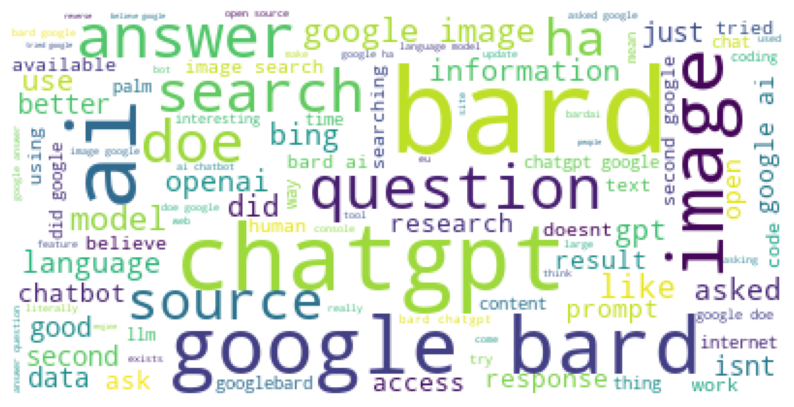

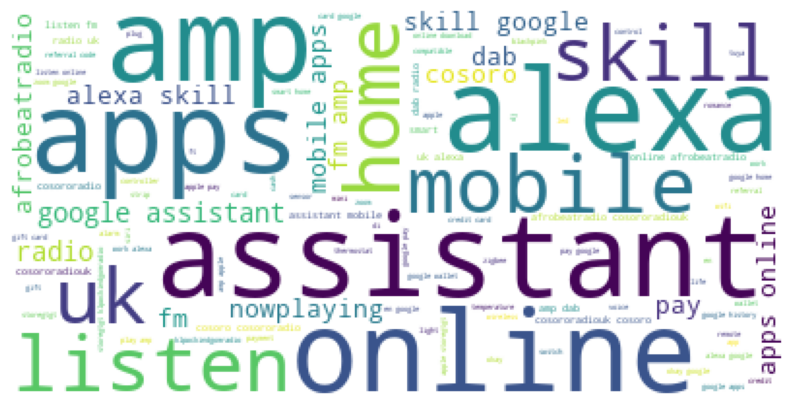

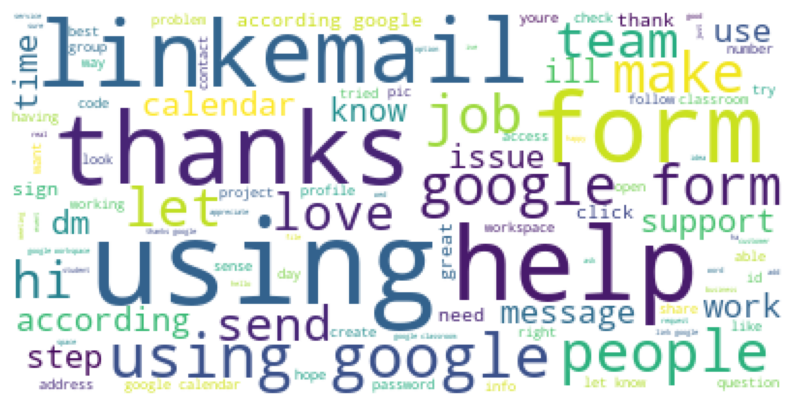

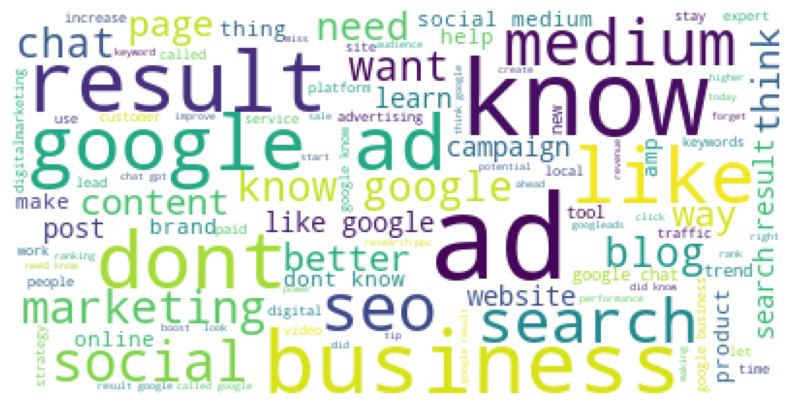

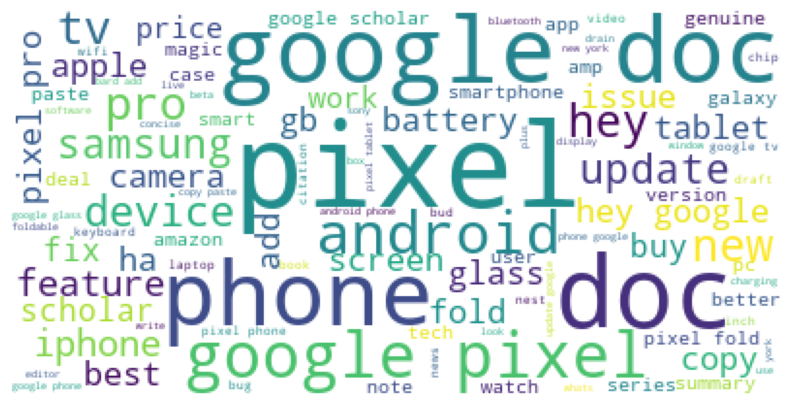

...

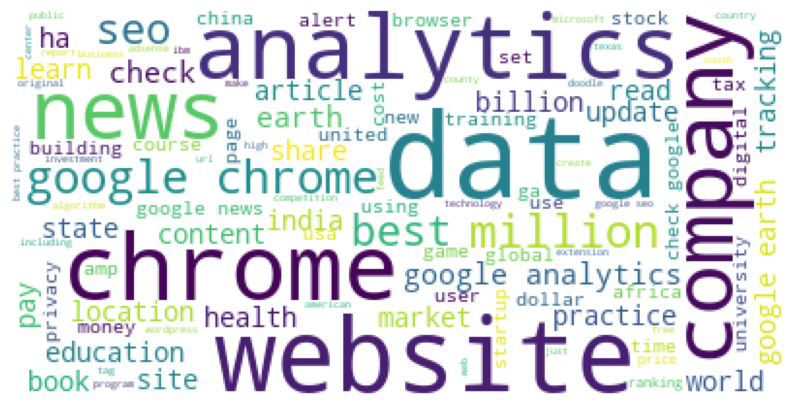

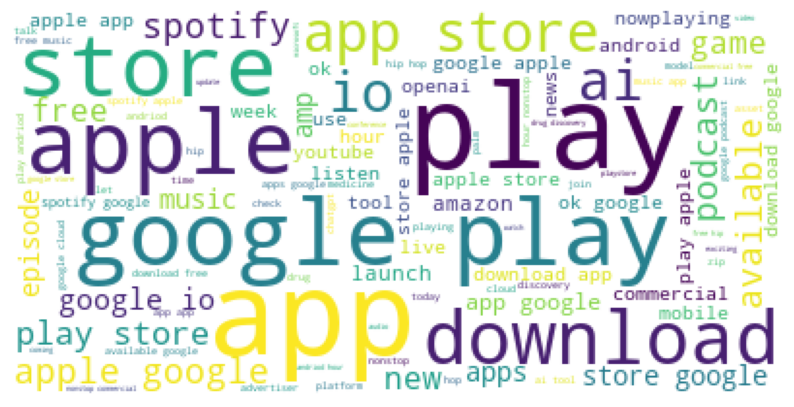

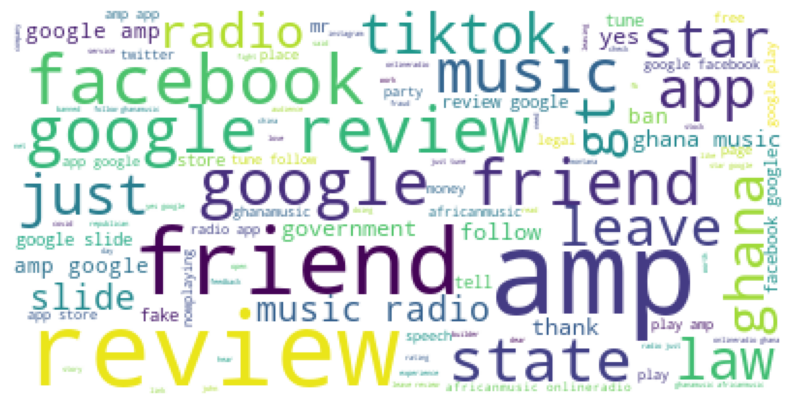

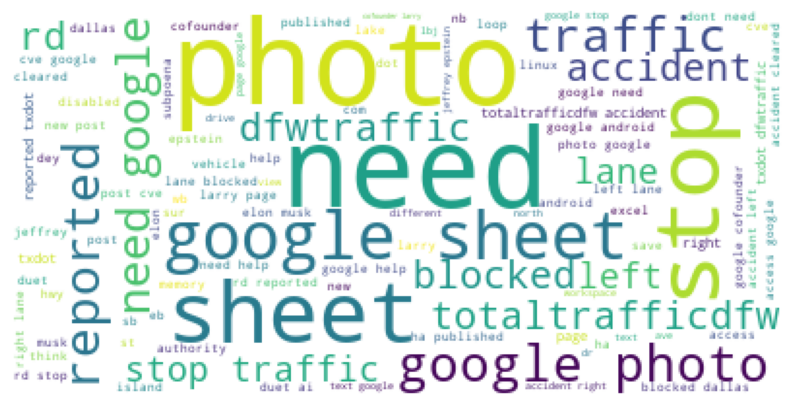

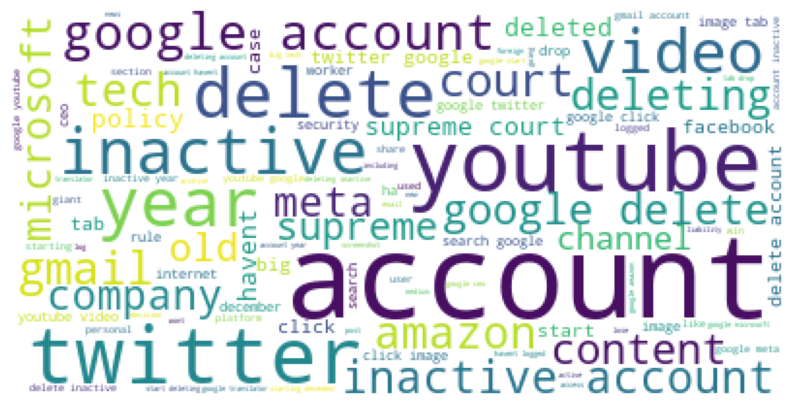

In [40]:
wc = WordCloud(background_color = 'white', max_font_size = 60)
for i in range(15):
    cloud = wc.generate_from_frequencies(gg[i])
    cloud.to_file('cluster15-maxfeature_5000' + str(i) + '.jpg')
    plt.figure(figsize = (10, 8))
    plt.axis('off')
    plt.imshow(cloud)
    plt.show()

In [2]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import sqlite3
import pandas as pd

In [3]:
db = sqlite3.connect('preprocgoogle.db')
df = pd.read_sql_query("select preproc from tweet", db)
df

,preproc
0,future proof google news follow u for latest n...
1,why dont you google it what would it cost you
2,ah fuuu i fucking love google auto complete
3,huawei kalau ade google balik sumpah top smart...
4,wow it is technically m on google searchweb we...
...,...
160248,im famous guyzzz pr ye qt kon hai jiski pic aa...
160249,google sink to new low brings up absolutely no...
160250,phone i have redmi and iphone se will get it t...
160251,desktop music player app designed by me full c...


In [4]:
count_vect = CountVectorizer()
fit_vect = count_vect.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect.shape)

CountVectorizer Shape: (160253, 98847)


In [5]:
lda = LatentDirichletAllocation()
lda.fit(fit_vect)

LatentDirichletAllocation()

In [6]:
print(lda.components_.shape)
lda.components_

(10, 98847)


array([[12.85211268,  0.9169498 ,  0.1       , ...,  0.1       ,
         0.10010755,  0.1       ],
       [ 6.59122439,  8.53973204,  0.1       , ...,  0.1       ,
         0.1       ,  0.1       ],
       [ 2.31976295,  0.1       ,  0.10005515, ...,  0.1       ,
         0.1       ,  0.1       ],
       ...,
       [ 0.10000396,  0.10000286,  0.1       , ...,  1.09977028,
         0.1       ,  0.1       ],
       [14.56048329,  7.53074887,  1.09994484, ...,  0.1       ,
         2.09982907,  0.1       ],
       [ 0.10003016,  0.10000224,  0.1       , ...,  0.1       ,
         0.10001129,  0.10002534]])

In [7]:
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

In [8]:
# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
display_topic_words(lda, feature_names, 15)


Topic # 0
google*8764.0 + the*7059.5 + to*6562.8 + and*5894.2 + ai*3946.4 + is*3865.5 + with*3281.7 + in*3052.2 + of*2609.1 + chatgpt*2104.5 + bard*1946.6 + for*1640.7 + how*1537.8 + it*1497.9 + are*1348.1

Topic # 1
google*12667.7 + the*4843.2 + my*4374.5 + for*3772.4 + me*3131.5 + of*2802.4 + on*2624.0 + is*2594.7 + this*2506.0 + it*2472.8 + im*2239.6 + and*2017.4 + to*1725.9 + what*1671.7 + first*1342.8

Topic # 2
google*11097.2 + bard*3863.5 + ai*3557.3 + in*3418.4 + to*3372.4 + search*3090.5 + and*2917.7 + for*2316.3 + on*2200.8 + is*1921.4 + by*1897.8 + chatgpt*1595.4 + new*1562.5 + at*1357.8 + more*1344.7

Topic # 3
the*25654.6 + google*12429.8 + of*10086.9 + and*9709.6 + in*8685.2 + for*6667.8 + on*6026.9 + to*5785.2 + is*4731.3 + app*4464.9 + play*3824.2 + it*3248.2 + from*3029.8 + store*2956.9 + with*2191.5

Topic # 4
google*12488.0 + to*9747.4 + account*6681.0 + for*3682.4 + on*3336.3 + you*2750.5 + your*2679.6 + it*2530.1 + will*2498.0 + youtube*2439.6 + year*2428.5 + my*2

In [9]:
lda.perplexity(fit_vect)

1511.1717301683734

In [ ]:
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(df['preproc'])
print('CountVectorizer Shape:', fit_vect.shape)

In [ ]:
lda = LatentDirichletAllocation(n_components=15,doc_topic_prior = 1, topic_word_prior=0.1,random_state=0)
lda.fit(fit_vect)

In [ ]:
# CountVectorizer객체내의 전체 word들의 명칭을 get_features_names( )를 통해 추출
feature_names = count_vect.get_feature_names_out()

# Topic별 가장 연관도가 높은 word를 15개만 추출
display_topic_words(lda, feature_names, 15)

In [ ]:
lda.perplexity(fit_vectct)

In [ ]:
ppls = []
for alpha in [0.1, 0.25, 0.5, 0.75, 1]:
    for beta in [0.1, 0.25, 0.5, 0.75, 1]:
        print(f'alpha: {alpha}, beta: {beta}')
        lda = LatentDirichletAllocation(n_components=15,doc_topic_prior = alpha, topic_word_prior=beta,random_state=0)
        lda.fit(fit_vect)
        display_topic_words(lda, feature_names, 15)
        ppl = lda.perplexity(fit_vect)
        print(f'perplexity: {ppl}')
        ppls.append((alpha, beta, ppl))
        print('=========================================')

In [ ]:
ppls

#Topic proportion

In [ ]:
import pickle
with open('lda_6_5.pickle', 'rb') as fp:
    lda = pickle.load(fp)

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

In [ ]:
with sqlite3.connect(r'.\database\preproc_6_5.db') as db:
    df = pd.read_sql_query("select tweetDate, rawContent from tweet where lang='en'", db)
df

In [ ]:
df['tweetDate'] = pd.to_datetime(df['tweetDate'])
df.tweetDate
daily_dfs = [day for day in df.groupby(df.tweetDate.dt.date)]
for day in daily_dfs:
    print(len(day[1]))

In [ ]:
for day in daily_dfs:
    print(day[0])

In [ ]:
tmp = daily_dfs[0][1].copy()
accum_dfs = [tmp]
for day in daily_dfs[1:]:
    tmp = pd.concat([tmp, day[1]])
    accum_dfs.append(tmp)

accum_dfs

In [ ]:
for day in accum_dfs:
    print(len(day))

In [ ]:
# 테스트용
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(accum_dfs[0].rawContent)
print('CountVectorizer Shape:', fit_vect.shape)

doc_topic = lda.transform(fit_vect)
# append(sum(col)/len(day)

doc_topic.shape

In [ ]:
proportions = []
for i in range(21):
    proportions.append([])
proportions

for idx, day in enumerate(accum_dfs):
    print(f'day {idx}')
    count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
    fit_vect = count_vect.fit_transform(day.rawContent)
    
    doc_topic = lda.transform(fit_vect)
    doc_topic = pd.DataFrame(doc_topic)
    
    for i in range(21):
        print(f'topic {i}: {sum(doc_topic[i])/len(day)}')
        proportions[i].append(sum(doc_topic[i])/len(day))

proportions

In [ ]:
import matplotlib.pyplot as plt

fig = plt.figure()
x = [str(day[0])[5:] for day in daily_dfs]
for i in range(21):
    plt.plot(x, proportions[i], label=f'topic{i}', marker='o')

plt.xlabel('date')
plt.ylabel('proportion')
fig.set_figwidth(15)
# plt.legend()
plt.show()

In [ ]:
fig = plt.figure()
x = [str(day[0])[5:] for day in daily_dfs]
for i in range(21):
    plt.plot(x, proportions[i], label=f'topic{i}', marker='o')

plt.xlabel('date')
plt.ylabel('proportion')
fig.set_figwidth(15)
plt.legend()
plt.show()

In [ ]:
with sqlite3.connect(r'preproc_6_4.db') as db:
    df = pd.read_sql_query("select * from tweet where lang='en'", db)
df

In [ ]:
doc = df.preproc.dropna()
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(doc)
print('CountVectorizer Shape:', fit_vect.shape)

ppls = []
min_ppl = 1000

for i in range(3, 26, 2):
    print(f'# of topics: {i}')
    lda = LatentDirichletAllocation(n_components=i,doc_topic_prior = 0.5, topic_word_prior=0.1,random_state=0)
    lda.fit(fit_vect)

    feature_names = count_vect.get_feature_names_out()

    display_topic_words(lda, feature_names, 15)
    
    current_ppl = lda.perplexity(fit_vect)
    print(f'perplexity: {current_ppl}')
    ppls.append((i,current_ppl))
    
    if current_ppl < min_ppl:
        min_ppl = current_ppl
        min_lda = lda

In [ ]:
import matplotlib.pyplot as plt

x = [t[0] for t in ppls]
y = [t[1] for t in ppls]

plt.plot(x,y)

plt.xlabel('number of topics')
plt.ylabel('perplexity')
plt.legend()
plt.show()

In [ ]:
with open('lda_6_5.pickle', 'wb') as fp:
    pickle.dump(min_lda, fp)

In [ ]:
#perpelexity graph each company

In [ ]:
#google perplexity

In [ ]:
df_g = df[df['companyName'] == 'google']['preproc']
def display_topic_words(model, feature_names, no_top_words):
    for topic_index, topic in enumerate(model.components_):
        print('\nTopic #',topic_index)

        # components_ array에서 가장 값이 큰 순으로 정렬했을 때, 그 값의 array index를 반환. 
        topic_word_indexes = topic.argsort()[::-1]
        top_indexes=topic_word_indexes[:no_top_words]

        # top_indexes대상인 index별로 feature_names에 해당하는 word feature 추출 후 join으로 concat
        feature_concat = ' + '.join([str(feature_names[i])+'*'+str(round(topic[i],1)) for i in top_indexes])                
        print(feature_concat)

In [ ]:
doc = df_g.dropna()
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(doc)
print('CountVectorizer Shape:', fit_vect.shape)

ppls = []
min_ppl = 1000

for i in range(3, 26, 2):
    print(f'# of topics: {i}')
    lda = LatentDirichletAllocation(n_components=i,doc_topic_prior = 0.5, topic_word_prior=0.1,random_state=0)
    lda.fit(fit_vect)

    feature_names = count_vect.get_feature_names_out()

    display_topic_words(lda, feature_names, 15)
    
    current_ppl = lda.perplexity(fit_vect)
    print(f'perplexity: {current_ppl}')
    ppls.append((i,current_ppl))
    
    if current_ppl < min_ppl:
        min_ppl = current_ppl
        min_lda = lda

In [ ]:
import matplotlib.pyplot as plt

x = [t[0] for t in ppls]
y = [t[1] for t in ppls]

plt.plot(x,y)

plt.xlabel('number of topics')
plt.ylabel('perplexity')
plt.legend()
plt.show()

In [ ]:
#apple perplexity

In [ ]:
df_ap = df[df['companyName'] == 'apple']['preproc']
doc = df_ap.dropna()
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(doc)
print('CountVectorizer Shape:', fit_vect.shape)

ppls = []
min_ppl = 1000

for i in range(3, 26, 2):
    print(f'# of topics: {i}')
    lda = LatentDirichletAllocation(n_components=i,doc_topic_prior = 0.5, topic_word_prior=0.1,random_state=0)
    lda.fit(fit_vect)

    feature_names = count_vect.get_feature_names_out()

    display_topic_words(lda, feature_names, 15)
    
    current_ppl = lda.perplexity(fit_vect)
    print(f'perplexity: {current_ppl}')
    ppls.append((i,current_ppl))
    
    if current_ppl < min_ppl:
        min_ppl = current_ppl
        min_lda = lda

In [ ]:
import matplotlib.pyplot as plt

x = [t[0] for t in ppls]
y = [t[1] for t in ppls]

plt.plot(x,y)

plt.xlabel('number of topics')
plt.ylabel('perplexity')
plt.legend()
plt.show()

In [ ]:
#amazon perplexity

In [ ]:
df_am = df[df['companyName'] == 'amazon']['preproc']
doc = df_am.dropna()
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(doc)
print('CountVectorizer Shape:', fit_vect.shape)

ppls = []
min_ppl = 1000

for i in range(3, 26, 2):
    print(f'# of topics: {i}')
    lda = LatentDirichletAllocation(n_components=i,doc_topic_prior = 0.5, topic_word_prior=0.1,random_state=0)
    lda.fit(fit_vect)

    feature_names = count_vect.get_feature_names_out()

    display_topic_words(lda, feature_names, 15)
    
    current_ppl = lda.perplexity(fit_vect)
    print(f'perplexity: {current_ppl}')
    ppls.append((i,current_ppl))
    
    if current_ppl < min_ppl:
        min_ppl = current_ppl
        min_lda = lda

In [ ]:
import matplotlib.pyplot as plt

x = [t[0] for t in ppls]
y = [t[1] for t in ppls]

plt.plot(x,y)

plt.xlabel('number of topics')
plt.ylabel('perplexity')
plt.legend()
plt.show()

In [ ]:
#nvidia perplexity

In [ ]:
df_n = df[df['companyName'] == 'nvidia']['preproc']
doc = df_n.dropna()
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(doc)
print('CountVectorizer Shape:', fit_vect.shape)

ppls = []
min_ppl = 1000

for i in range(3, 26, 2):
    print(f'# of topics: {i}')
    lda = LatentDirichletAllocation(n_components=i,doc_topic_prior = 0.5, topic_word_prior=0.1,random_state=0)
    lda.fit(fit_vect)

    feature_names = count_vect.get_feature_names_out()

    display_topic_words(lda, feature_names, 15)
    
    current_ppl = lda.perplexity(fit_vect)
    print(f'perplexity: {current_ppl}')
    ppls.append((i,current_ppl))
    
    if current_ppl < min_ppl:
        min_ppl = current_ppl
        min_lda = lda
        


In [ ]:
import matplotlib.pyplot as plt

x = [t[0] for t in ppls]
y = [t[1] for t in ppls]

plt.plot(x,y)

plt.xlabel('number of topics')
plt.ylabel('perplexity')
plt.legend()
plt.show()

In [ ]:
#microsoft perplexity

In [ ]:
df_ms = df[df['companyName'] == 'microsoft']['preproc']
doc = df_ms.dropna()
count_vect = CountVectorizer(max_df=0.5, max_features=1000, min_df=2, stop_words='english', ngram_range=(1,2))
fit_vect = count_vect.fit_transform(doc)
print('CountVectorizer Shape:', fit_vect.shape)

ppls = []
min_ppl = 1000

for i in range(3, 26, 2):
    print(f'# of topics: {i}')
    lda = LatentDirichletAllocation(n_components=i,doc_topic_prior = 0.5, topic_word_prior=0.1,random_state=0)
    lda.fit(fit_vect)

    feature_names = count_vect.get_feature_names_out()

    display_topic_words(lda, feature_names, 15)
    
    current_ppl = lda.perplexity(fit_vect)
    print(f'perplexity: {current_ppl}')
    ppls.append((i,current_ppl))
    
    if current_ppl < min_ppl:
        min_ppl = current_ppl
        min_lda = lda

In [ ]:

x = [t[0] for t in ppls]
y = [t[1] for t in ppls]

plt.plot(x,y)

plt.xlabel('number of topics')
plt.ylabel('perplexity')
plt.legend()
plt.show()